In [1]:
#Import Libraries
import pandas as pd
%matplotlib inline
from MCForecastTools import MCSimulation
import warnings
warnings.filterwarnings('ignore')
from pathlib import Path
import plotly.express as px
import numpy as np

Bit Coin (BTC)

Ethereum (ETH)

Dogecoin (DOGE)

Litecoin (LTC)

In [2]:
# Reading in the Pre-Covid time frame csv files
btc_pre = pd.read_csv(Path('./Resources/BTC_PRECOVID.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)
doge_pre = pd.read_csv(Path('./Resources/DOGE_PRECOVID.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)
eth_pre = pd.read_csv(Path('./Resources/ETH_PRECOVID.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)
ltc_pre = pd.read_csv(Path('./Resources/LTC_PRECOVID.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)

In [3]:
# Reading in the Covid time frame csv files
btc_covid = pd.read_csv(Path('./Resources/BTC_COVID.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)
doge_covid = pd.read_csv(Path('./Resources/DOGE_COVID.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)
eth_covid = pd.read_csv(Path('./Resources/ETH_COVID.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)
ltc_covid = pd.read_csv(Path('./Resources/LTC_COVID.csv')).set_index('Date').drop(labels = ['Open','High','Low','Adj Close','Volume'], axis = 1)

In [4]:
# Reading in the Post-Covid time frame csv files
btc_post = pd.read_csv(Path('./Resources/BTC_POST.csv')).set_index('Date')
doge_post = pd.read_csv(Path('./Resources/DOGE_POST.csv')).set_index('Date')
eth_post = pd.read_csv(Path('./Resources/ETH_POST.csv')).set_index('Date')
ltc_post = pd.read_csv(Path('./Resources/LTC_POST.csv')).set_index('Date')

In [5]:
# Concatenating the Pre-Covid time frame data frames
crypto_pre = pd.concat([btc_pre, doge_pre, eth_pre, ltc_pre], axis=1, join='inner')
crypto_pre.columns = ['BTC', 'DOGE', 'ETH', 'LTC']
print(crypto_pre.isnull().sum())
crypto_pre.head()

BTC     0
DOGE    0
ETH     0
LTC     0
dtype: int64


,BTC,DOGE,ETH,LTC
Date,,,,
11/9/2017,7143.580078,0.001415,320.884003,64.269699
11/10/2017,6618.140137,0.001163,299.252991,59.260101
11/11/2017,6357.600098,0.001201,314.681000,62.303299
11/12/2017,5950.069824,0.001038,307.907990,59.005402
11/13/2017,6559.490234,0.001211,316.716003,61.396500


In [68]:
# Finding the index for minumum and maximum value of all cryptos
pre_high_date = crypto_pre.idxmax()
pre_low_date = crypto_pre.idxmin()
btc_pre_high_date = pre_high_date[0]
btc_pre_low_date = pre_low_date[0]
doge_pre_high_date = pre_high_date[1]
doge_pre_low_date = pre_low_date[1]
eth_pre_high_date = pre_high_date[2]
eth_pre_low_date = pre_low_date[2]
ltc_pre_high_date = pre_high_date[3]
ltc_pre_low_date = pre_low_date[3]

# Finding the minimum and maximum value for all cryptos
pre_high_value =  crypto_pre.max()
pre_low_value = crypto_pre.min()
btc_pre_high = round(pre_high_value[0],2)
btc_pre_low = round(pre_low_value[0],2)
doge_pre_high = pre_high_value[1]
doge_pre_low = pre_low_value[1]
eth_pre_high = round(pre_high_value[2],2)
eth_pre_low = round(pre_low_value[2],2)
ltc_pre_high = round(pre_high_value[3],2)
ltc_pre_low = round(pre_low_value[3],2)

# Printing the results
print('Pre-Covid Highs/Lows''\n'
     '-----------------------''\n'
f'Bitcoin High of ${btc_pre_high} on {btc_pre_high_date} | Bitcoin Low of ${btc_pre_low} on {btc_pre_low_date}''\n'
      '________________________________________________________________________________''\n'
      '\n'
f'Dogecoin High of ${doge_pre_high} on {doge_pre_high_date} | Dogecoin Low of ${doge_pre_low} on {doge_pre_low_date}''\n'
      '________________________________________________________________________________''\n'
      '\n'
f'Ethereum High of ${eth_pre_high} on {eth_pre_high_date} | Ethereum Low of ${eth_pre_low} on {eth_pre_low_date}''\n'
      '________________________________________________________________________________''\n'
      '\n'
f'Litecoin High of ${ltc_pre_high} on {ltc_pre_high_date} | Litecoin Low of ${ltc_pre_low} on {ltc_pre_low_date}''\n'
     '________________________________________________________________________________')



Pre-Covid Highs/Lows
-----------------------
Bitcoin High of $19497.4 on 12/16/2017 | Bitcoin Low of $3236.76 on 12/15/2018
________________________________________________________________________________

Dogecoin High of $0.017088 on 1/7/2018 | Dogecoin Low of $0.001038 on 11/12/2017
________________________________________________________________________________

Ethereum High of $1396.42 on 1/13/2018 | Ethereum Low of $84.31 on 12/14/2018
________________________________________________________________________________

Litecoin High of $358.34 on 12/18/2017 | Litecoin Low of $23.46 on 12/14/2018
________________________________________________________________________________


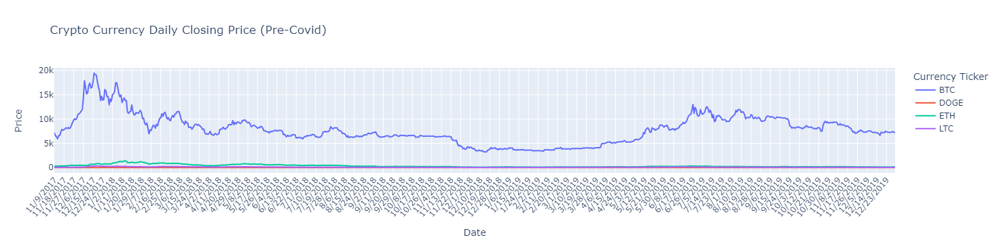

In [7]:
# Plotting daily prices from Pre-Covid time frame
crypto_pre_plot = px.line(crypto_pre, title='Crypto Currency Daily Closing Price (Pre-Covid)').update_layout(legend_title_text = 'Currency Ticker', yaxis_title = 'Price').update_xaxes(tickangle=310)
crypto_pre_plot

In [8]:
# Calculating Daily Return for all crypto currencies
crypto_pre_change = crypto_pre.pct_change().dropna()
crypto_pre_change.head(5)

,BTC,DOGE,ETH,LTC
Date,,,,
11/10/2017,-0.073554,-0.178092,-0.067411,-0.077946
11/11/2017,-0.039368,0.032674,0.051555,0.051353
11/12/2017,-0.064101,-0.135720,-0.021523,-0.052933
11/13/2017,0.102422,0.166667,0.028606,0.040523
11/14/2017,0.011626,-0.022296,0.066037,0.020899


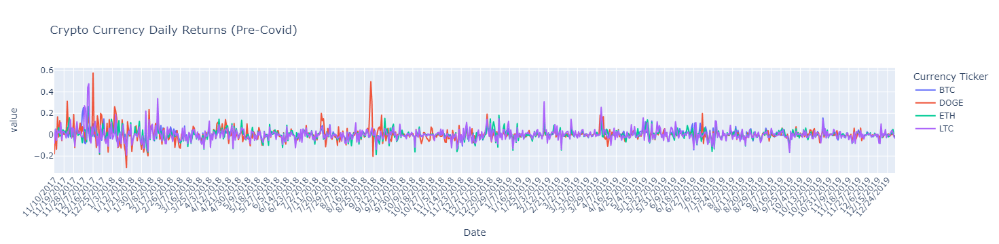

In [9]:
# Plotting the daily return
crypto_pre_ret_plot = px.line(crypto_pre_change, title='Crypto Currency Daily Returns (Pre-Covid)').update_layout(legend_title_text = 'Currency Ticker').update_xaxes(tickangle=310)
crypto_pre_ret_plot

In [10]:
# Calculating the cumulative daily return
crypto_pre_cum_ret = (1+crypto_pre_change).cumprod()
crypto_pre_cum_ret

,BTC,DOGE,ETH,LTC
Date,,,,
11/10/2017,0.926446,0.821908,0.932589,0.922054
11/11/2017,0.889974,0.848763,0.980669,0.969404
11/12/2017,0.832925,0.733569,0.959562,0.918091
11/13/2017,0.918236,0.855830,0.987011,0.955295
11/14/2017,0.928911,0.836749,1.052190,0.975259
...,...,...,...,...
12/27/2019,1.020509,1.450883,0.396450,0.640709
12/28/2019,1.024415,1.458657,0.399904,0.666605
12/29/2019,1.039066,1.461484,0.419959,0.679491


In [11]:
# Calculating the standard deviation
crypto_pre_std = crypto_pre_change.std()*np.sqrt(252)
crypto_pre_std

BTC     0.675194
DOGE    1.027625
ETH     0.806472
LTC     0.945852
dtype: float64

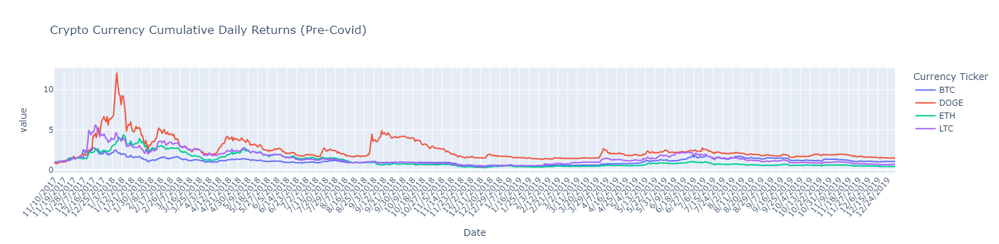

In [12]:
# Plotting the cumulative daily return
crypto_pre_cum_ret_plot = px.line(crypto_pre_cum_ret, title='Crypto Currency Cumulative Daily Returns (Pre-Covid)').update_layout(legend_title_text = 'Currency Ticker').update_xaxes(tickangle=310)
crypto_pre_cum_ret_plot

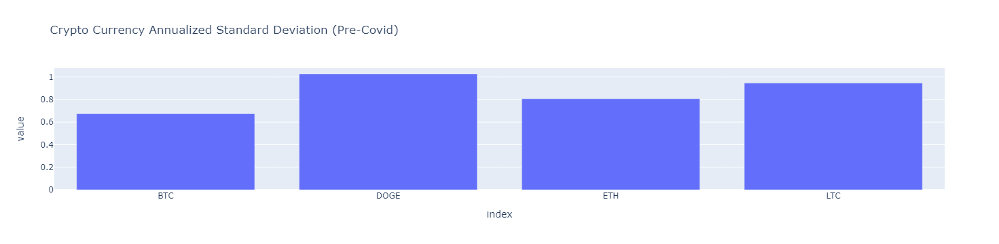

In [13]:
# Plotting the standard deviation
crypto_pre_std_plot = px.bar(crypto_pre_std, title = 'Crypto Currency Annualized Standard Deviation (Pre-Covid)').update_layout(showlegend = False)
crypto_pre_std_plot

In [14]:
# Concatenating the Covid time frame data frames
crypto_covid = pd.concat([btc_covid, doge_covid, eth_covid, ltc_covid], axis=1,join='inner', keys = ["BTC", "DOGE", "ETH", "LTC"])
crypto_covid.columns = ["BTC", "DOGE", "ETH", "LTC"]
print(crypto_covid.isnull().sum())
crypto_covid.head()

BTC     0
DOGE    0
ETH     0
LTC     0
dtype: int64


,BTC,DOGE,ETH,LTC
Date,,,,
1/1/2020,7200.174316,0.002033,130.802002,42.017719
1/2/2020,6985.470215,0.002009,127.410179,39.823013
1/3/2020,7344.884277,0.002145,134.171707,42.415573
1/4/2020,7410.656738,0.002241,135.069366,43.326607
1/5/2020,7411.317383,0.002419,136.276779,43.553207


In [72]:
# Finding the index for minumum and maximum value of all cryptos
cov_high_date = crypto_covid.idxmax()
cov_low_date = crypto_covid.idxmin()
btc_cov_high_date = cov_high_date[0]
btc_cov_low_date = cov_low_date[0]
doge_cov_high_date = cov_high_date[1]
doge_cov_low_date = cov_low_date[1]
eth_cov_high_date = cov_high_date[2]
eth_cov_low_date = cov_low_date[2]
ltc_cov_high_date = cov_high_date[3]
ltc_cov_low_date = cov_low_date[3]

# Finding the minimum and maximum value for all cryptos
cov_high_value =  crypto_covid.max()
cov_low_value = crypto_covid.min()
btc_cov_high = round(cov_high_value[0],2)
btc_cov_low = round(cov_low_value[0],2)
doge_cov_high = cov_high_value[1]
doge_cov_low = cov_low_value[1]
eth_cov_high = round(cov_high_value[2],2)
eth_cov_low = round(cov_low_value[2],2)
ltc_cov_high = round(cov_high_value[3],2)
ltc_cov_low = round(cov_low_value[3],2)



# Printing the results
print('Covid Highs/Lows''\n'
     '-----------------------''\n'
f'Bitcoin High of ${btc_cov_high} on {btc_cov_high_date} | Bitcoin Low of ${btc_cov_low} on {btc_cov_low_date}''\n'
      '________________________________________________________________________________''\n'
      '\n'
f'Dogecoin High of ${doge_cov_high} on {doge_cov_high_date} | Dogecoin Low of ${doge_cov_low} on {doge_cov_low_date}''\n'
      '________________________________________________________________________________''\n'
      '\n'
f'Ethereum High of ${eth_cov_high} on ${eth_cov_high_date} | Ethereum Low of ${eth_cov_low} on ${eth_cov_low_date}''\n'
      '________________________________________________________________________________''\n'
      '\n'
f'Litecoin High of ${ltc_cov_high} on {ltc_cov_high_date} | Litecoin Low of ${ltc_cov_low} on {ltc_cov_low_date}''\n'
     '________________________________________________________________________________')

Covid Highs/Lows
-----------------------
Bitcoin High of $67566.83 on 11/8/2021 | Bitcoin Low of $4970.79 on 3/12/2020
________________________________________________________________________________

Dogecoin High of $0.684777 on 5/7/2021 | Dogecoin Low of $0.001537 on 3/12/2020
________________________________________________________________________________

Ethereum High of $4812.09 on $11/8/2021 | Ethereum Low of $110.61 on $3/16/2020
________________________________________________________________________________

Litecoin High of $386.45 on 5/9/2021 | Litecoin Low of $30.93 on 3/12/2020
________________________________________________________________________________


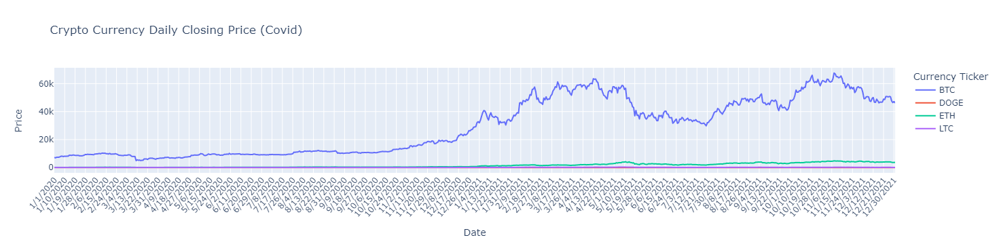

In [16]:
# Plotting daily prices from Covid time frame
crypto_covid_plot = px.line(crypto_covid, title='Crypto Currency Daily Closing Price (Covid)').update_layout(legend_title_text = 'Currency Ticker', yaxis_title = 'Price').update_xaxes(tickangle=310)
crypto_covid_plot

In [17]:
# Calculating the daily return
crypto_covid_change = crypto_covid.pct_change().dropna()
crypto_covid_change.head(5)

,BTC,DOGE,ETH,LTC
Date,,,,
1/2/2020,-0.029819,-0.011805,-0.025931,-0.052233
1/3/2020,0.051452,0.067695,0.053069,0.065102
1/4/2020,0.008955,0.044755,0.006690,0.021479
1/5/2020,0.000089,0.079429,0.008939,0.005230
1/6/2020,0.048291,0.018189,0.058905,0.051963


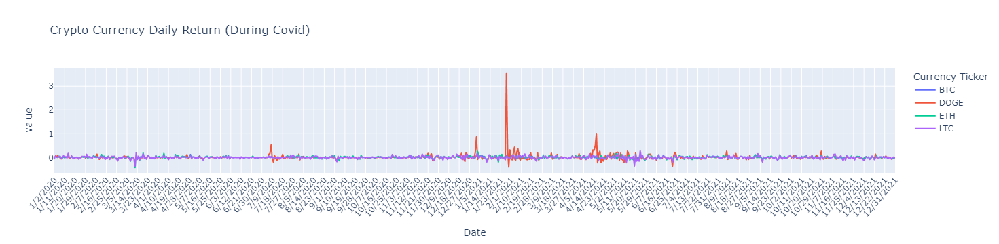

In [18]:
# Plotting the daily return
crypto_covid_ret_plot = px.line(crypto_covid_change, labels = 'Crypto Name', title = 'Crypto Currency Daily Return (During Covid)').update_layout(legend_title_text = 'Currency Ticker').update_xaxes(tickangle=310)
crypto_covid_ret_plot

In [19]:
# Calculating the cumulative return
crypto_covid_cum_ret = (1+crypto_covid_change).cumprod()
crypto_covid_cum_ret

,BTC,DOGE,ETH,LTC
Date,,,,
1/2/2020,0.970181,0.988195,0.974069,0.947767
1/3/2020,1.020098,1.055091,1.025762,1.009469
1/4/2020,1.029233,1.102312,1.032625,1.031151
1/5/2020,1.029325,1.189867,1.041855,1.036544
1/6/2020,1.079032,1.211510,1.103226,1.090406
...,...,...,...,...
12/27/2021,7.033221,92.329070,30.867629,3.709893
12/28/2021,6.609403,85.645352,29.058371,3.472032
12/29/2021,6.450498,82.520905,27.740644,3.463125


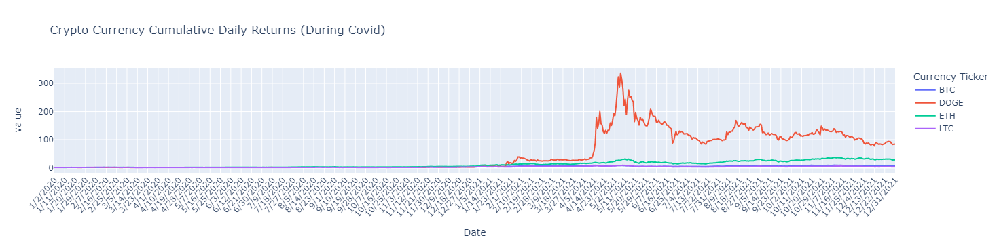

In [20]:
# Plotting the cumulative return
crypto_covid_cum_ret_plot = px.line(crypto_covid_cum_ret, title='Crypto Currency Cumulative Daily Returns (During Covid)').update_layout(legend_title_text = 'Currency Ticker').update_xaxes(tickangle=310)
crypto_covid_cum_ret_plot

In [21]:
# Calculating the standard deviation
crypto_covid_std = crypto_covid_change.std()*np.sqrt(252)
crypto_covid_std

BTC     0.634576
DOGE    2.549712
ETH     0.838042
LTC     0.892995
dtype: float64

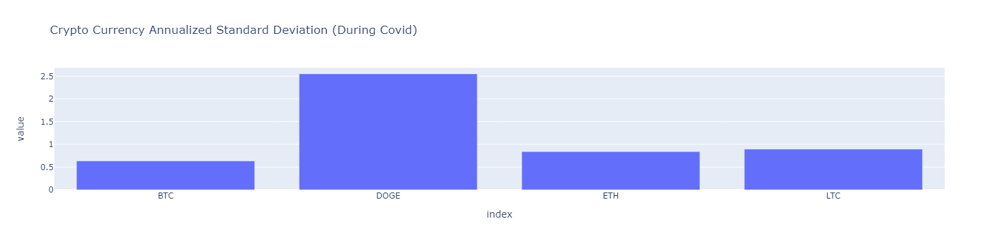

In [22]:
# Plotting the standard deviation 
crypto_covid_std_plot = px.bar(crypto_covid_std, title = 'Crypto Currency Annualized Standard Deviation (During Covid)')
crypto_covid_std_plot.update_layout(showlegend = False)

In [23]:
btc_post.rename(columns=str.lower, inplace=True)
doge_post.rename(columns=str.lower, inplace=True)
eth_post.rename(columns=str.lower, inplace=True)
ltc_post.rename(columns=str.lower, inplace=True)

In [24]:
#Concatenating the Post-Covid time frame data frames
crypto_post = pd.concat([btc_post, doge_post, eth_post, ltc_post], axis=1,join='inner', keys = ["BTC", "DOGE", "ETH", "LTC"])
print(crypto_post.isnull().sum())
crypto_post.head()

BTC   open         0
      high         0
      low          0
      close        0
      adj close    0
      volume       0
DOGE  open         0
      high         0
      low          0
      close        0
      adj close    0
      volume       0
ETH   open         0
      high         0
      low          0
      close        0
      adj close    0
      volume       0
LTC   open         0
      high         0
      low          0
      close        0
      adj close    0
      volume       0
dtype: int64


BTC                                                      \
                 open         high          low        close    adj close   
Date                                                                        
1/1/2022  46311.74609  47827.31250  46288.48438  47686.81250  47686.81250   
1/2/2022  47680.92578  47881.40625  46856.93750  47345.21875  47345.21875   
1/3/2022  47343.54297  47510.72656  45835.96484  46458.11719  46458.11719   
1/4/2022  46458.85156  47406.54688  45752.46484  45897.57422  45897.57422   
1/5/2022  45899.35938  46929.04688  42798.22266  43569.00391  43569.00391   

                            DOGE                                ...  \
                volume      open      high       low     close  ...   
Date                                                            ...   
1/1/2022  2.458267e+10  0.170510  0.173423  0.170353  0.173035  ...   
1/2/2022  2.795157e+10  0.173027  0.175989  0.171201  0.174403  ...   
1/3/2022  3.307163e+10  0.174406  0.174406  0.168271  0.170088  ...   
1/4/2022  4.249468e+10  0.170151  0.172339  0.168128  0.168803  ...   
1/5/2022  3.685108e+10  0.168835  0.170747  0.151898  0.159420  ...   

                  ETH                                                LTC  \
                  low        close    adj close       volume        open   
Date                                                                       
1/1/2022  3682.286621  3769.697021  3769.697021   9776191466  146.536865   
1/2/2022  3727.357422  3829.564941  3829.564941   9881471548  150.685303   
1/3/2022  3698.047607  3761.380371  3761.380371  12080777893  151.263397   
1/4/2022  3723.349854  3794.056641  3794.056641  14030925983  148.467773   
1/5/2022  3456.745361  3550.386963  3550.386963  18061338502  146.811295   

                                                                      
                high         low       close   adj close      volume  
Date                                                                  
1/1/2022  150.751999  146.456940  150.697433  150.697433   691648227  
1/2/2022  152.936035  148.663101  151.255493  151.255493   680239631  
1/3/2022  151.263397  146.674194  148.461594  148.461594   755658603  
1/4/2022  151.332062  146.563065  146.812286  146.812286   789511706  
1/5/2022  149.545227  132.100754  136.089111  136.089111  1304198400  

[5 rows x 24 columns]

In [66]:
# Finding the index for minumum and maximum value of all cryptos
post_high_date = crypto_post.idxmax()
post_low_date = crypto_post.idxmin()
btc_post_high_date = post_high_date[3]
btc_post_low_date = post_low_date[3]
doge_post_high_date = post_high_date[9]
doge_post_low_date = post_low_date[9]
eth_post_high_date = post_high_date[15]
eth_post_low_date = post_low_date[15]
ltc_post_high_date = post_high_date[21]
ltc_post_low_date = post_low_date[21]

# Finding the minimum and maximum value for all cryptos
post_high_value =  crypto_post.max()
post_low_value = crypto_post.min()
btc_post_high = round(post_high_value[3],2)
btc_post_low = round(post_low_value[3],2)
doge_post_high = post_high_value[9]
doge_post_low = post_low_value[9]
eth_post_high = round(post_high_value[15],2)
eth_post_low = round(post_low_value[15],2)
ltc_post_high = round(post_high_value[21],2)
ltc_post_low = round(post_low_value[21],2)

# Printing the results
print('Post-Covid Highs/Lows''\n'
     '-----------------------''\n'
f'Bitcoin High of ${btc_post_high} on {btc_post_high_date} | Bitcoin Low of ${btc_post_low} on {btc_post_low_date}''\n'
      '________________________________________________________________________________''\n'
      '\n'
f'Dogecoin High of ${doge_post_high} on {doge_post_high_date} | Dogecoin Low of ${doge_post_low} on {doge_post_low_date}''\n'
      '________________________________________________________________________________''\n'
      '\n'
f'Ethereum High of ${eth_post_high} on ${eth_post_high_date} | Ethereum Low of ${eth_post_low} on ${eth_post_low_date}''\n'
      '________________________________________________________________________________''\n'
      '\n'
f'Litecoin High of ${ltc_post_high} on {ltc_post_high_date} | Litecoin Low of ${ltc_post_low} on {ltc_post_low_date}''\n'
     '________________________________________________________________________________')


Post-Covid Highs/Lows
-----------------------
Bitcoin High of $47686.81 on 1/1/2022 | Bitcoin Low of $15787.28 on 11/21/2022
________________________________________________________________________________

Dogecoin High of $0.185103 on 1/15/2022 | Dogecoin Low of $0.053012 on 6/18/2022
________________________________________________________________________________

Ethereum High of $3829.56 on $1/2/2022 | Ethereum Low of $993.64 on $6/18/2022
________________________________________________________________________________

Litecoin High of $151.67 on 1/17/2022 | Litecoin Low of $43.3 on 6/13/2022
________________________________________________________________________________


In [26]:
# Setting the varaibles to be used in the simulation
num_sims = 100
trading_days = 252*10

In [27]:
# Setting the parameters for the monte carlo simulation
MC_POST = MCSimulation(
    portfolio_data = crypto_post,
    num_simulation = num_sims,
    num_trading_days = trading_days
)

In [28]:
# Running the cumulative return simulation
MC_cum_ret = MC_POST.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.


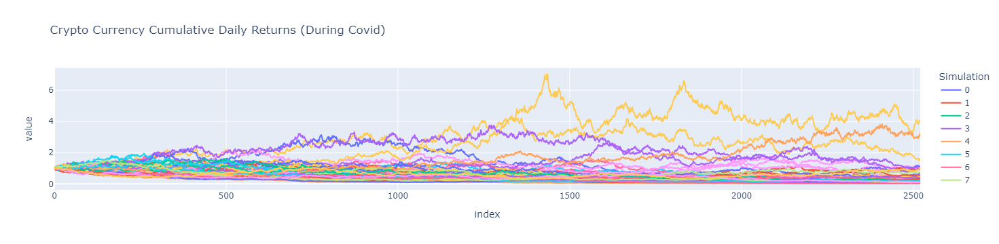

In [29]:
MC_plot = px.line(MC_cum_ret, title='Crypto Currency Cumulative Daily Returns (During Covid)').update_layout(legend_title_text = 'Simulation')
MC_plot

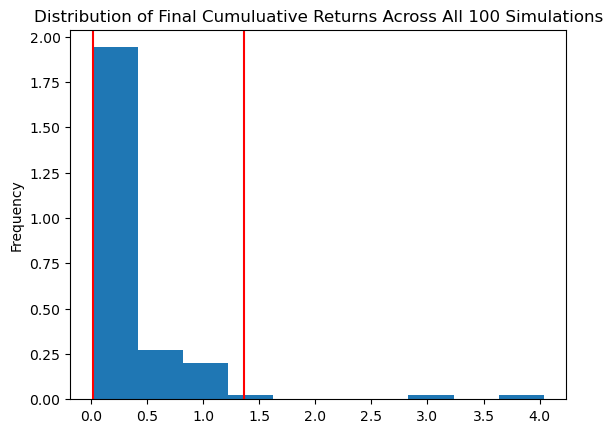

In [30]:
MC_dist_plot = MC_POST.plot_distribution()

In [31]:
# Getting the summary of the monte carlo simulation
sim_stats_10y = MC_POST.summarize_cumulative_return()
print(sim_stats_10y)

count           100.000000
mean              0.353568
std               0.559886
min               0.017244
25%               0.085409
50%               0.184075
75%               0.370180
max               4.035948
95% CI Lower      0.022465
95% CI Upper      1.362321
Name: 2520, dtype: float64


In [35]:
# Set initial investment 
# Including an input statement to give more options in initial investment. 
initial_investment_10y = int(input('What would you like your initial investment to be?(Please use whole numbers.)'))
# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our initial investment
ci_lower_10y = round(sim_stats_10y[8]*initial_investment_10y,2)
ci_upper_10y = round(sim_stats_10y[9]*initial_investment_10y,2)

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment_10y} in the portfolio"
      f" over the next 10 years will end within in the range of"
      f" ${ci_lower_10y} and ${ci_upper_10y}")

What would you like your initial investment to be?(Please use whole numbers.) 100


There is a 95% chance that an initial investment of $100 in the portfolio over the next 10 years will end within in the range of $2.25 and $136.23
